# Creating a unified subset of Nightside Data 
In this notebook, we will create the final version of the data file necessary for nightside data. Spanning from the year 1983 to 2012. In future iterations, we can hopefully add more data as time comes. For now, this module will be the conglomeration of the nightside data for OCB crossings from the DMSP missions (NASA). 

In [1]:
import pandas as pd
# importing the preliminary data
pre_df = pd.read_csv('data/allOCB_and_b2i.csv')
pre_df.head()

,Date1(UTC),MagLat1,Date2(UTC),MagLat2,MLT1,MLT2
0,1983-12-01 00:30:42,-78.71,1983-12-01 00:27:16,-67.17,18.37,18.26
1,1983-12-01 00:38:35,-75.03,1983-12-01 00:40:11,-69.69,5.90,5.97
2,1983-12-01 01:20:21,78.50,1983-12-01 01:16:29,67.15,4.38,5.15
3,1983-12-01 01:28:52,73.51,1983-12-01 01:31:18,65.74,18.94,18.58
4,1983-12-01 02:10:01,-75.96,1983-12-01 02:06:54,-65.79,19.53,18.99


So as we can see, in the data above, we have 400,000ish data points as of now. Looking at the data, the time lag between OCB and B2I boundaries are approximately 3 minutes for each pass. So in the southern hemisphere, the DMSP satellite reaches the B2I boundary first, and then the OCB, and then crosses the OCB to then cross the B2I again. Here, we can approximate that the time at each boundary is just the OCB boundary date and time data.

In [2]:
# Renaming the columns real quick
pre_df = pre_df.rename(columns={'Date1(UTC)': 'Date(UTC)_OCB', 'MagLat1' : 'MagLat_OCB', 'Date2(UTC)': 'Date(UTC)_B2I', 'MagLat2' : 'MagLat_B2I', 'MLT1' : 'MLT_OCB', 'MLT2' : 'MLT_B2I'})
# Shifting the columns over
col = pre_df.pop('MLT_OCB')
pre_df.insert(2, 'MLT_OCB', col)
pre_df['datetime_str'] = pre_df['Date(UTC)_OCB']
pre_df['Date_UTC'] = pd.to_datetime(pre_df['datetime_str'], format='%Y-%m-%d %H:%M:%S')
pre_df = pre_df.drop(columns=['Date(UTC)_OCB', 'datetime_str', 'Date(UTC)_B2I'])
print(pre_df.shape)
pre_df.tail()

(399528, 5)


,MagLat_OCB,MLT_OCB,MagLat_B2I,MLT_B2I,Date_UTC
399523,-77.85,1.63,-69.08,22.29,2009-12-31 10:39:01
399524,-83.92,1.61,-68.70,21.24,2009-12-31 12:20:57
399525,84.54,13.41,70.46,18.93,2009-12-31 14:52:11
399526,-85.94,14.83,-71.64,19.27,2009-12-31 15:42:51
399527,87.74,12.63,71.40,19.12,2009-12-31 16:33:24


As we can see, the nightside data encompasses times from December of 1983 all the way to december of 2009. Below we have the added nightside files provided by Tom Sotirelis of JHU APL, spanning from 2010-2012. In this notebook, our aim is to add the two data files together and see a comprehensive plot of the data. As of now our data is up to December of 2009. However, I noticed that there were 2 n_2009.txt files, where one of them was 4.6 mb, and the other 7.8 mb. I choose to use the larger file. Below, I am accumulating all the data files necessary for nightside. It is interesting that the format for nightside switches in 2009 to include an index in every column, rather than in previous years where it was just after the ocb boundary.

In [3]:
# run this cell to import all nightside data, creating a more unified process from start to finish.
import os 
from datetime import datetime

folder_paths = ["nightside"] # The entirity of the nightside data accumulated, from 1983-2008

# Function to convert the first column into a datetime object
def convert_to_datetime(df, year):
    df['date'] = pd.to_timedelta(df['date'], unit='s') + pd.Timestamp(year)
    return df

# List to accumulate DataFrames
all_dataframes = []

for folder_path in folder_paths:
    files = os.listdir(folder_path)
    
    for file_name in files:
        if file_name.startswith("n_") and file_name.endswith(".txt"):
            year_str = file_name.split("_")[1].split(".")[0]
            
            if year_str.isdigit():
                year = datetime(int(year_str), 1, 1)
                
                # Read the file using whitespace as a delimiter
                file_path = os.path.join(folder_path, file_name)
                nightside_df = pd.read_csv(
                    file_path,  # Correct file path usage
                    delim_whitespace=True,  # Use any whitespace as a delimiter
                    low_memory=False,
                    names=[
                        'date1', 'geo_lat1', 'geo_long1', 'mag_lat1', 'mag_long1', 'mlt1',
                        'date2', 'geo_lat2', 'geo_long2', 'mag_lat2', 'mag_long2', 'mlt2',
                        'date3', 'geo_lat3', 'geo_long3', 'mag_lat3', 'mag_long3', 'mlt3',
                        'date4', 'geo_lat4', 'geo_long4', 'mag_lat4', 'mag_long4', 'mlt4',
                        'date5', 'geo_lat5', 'geo_long5', 'mag_lat5', 'mag_long5', 'mlt5',
                        'date6', 'geo_lat6', 'geo_long6', 'mag_lat6', 'mag_long6', 'mlt6',
                        'date7', 'geo_lat7', 'geo_long7', 'mag_lat7', 'mag_long7', 'mlt7', 'index7'
                    ]
                )

                # Convert the first date columns to datetime
                for i in range(1, 8):
                    nightside_df[f'date{i}'] = pd.to_timedelta(nightside_df[f'date{i}'], unit='s') + pd.Timestamp(year)
                
                # Append the DataFrame to the list
                all_dataframes.append(nightside_df)

# Concatenate all DataFrames into a single DataFrame
combined_nightside_df = pd.concat(all_dataframes, ignore_index=True)

# Example: Sort by the first date column
#combined_nightside_df.sort_values(by='date1', inplace=True)

# Show the DataFrame summary
combined_nightside_df.describe() 

,date1,geo_lat1,geo_long1,mag_lat1,mag_long1,mlt1,date2,geo_lat2,geo_long2,mag_lat2,...,mag_lat6,mag_long6,mlt6,date7,geo_lat7,geo_long7,mag_lat7,mag_long7,mlt7,index7
count,556200,556200.000000,556200.000000,556200.000000,556200.000000,556200.000000,556200,556200.000000,556200.000000,556200.000000,...,556200.000000,556200.000000,556200.000000,556200,556200.000000,556200.000000,556200.000000,556200.000000,556200.000000,556200.000000
mean,1998-03-03 13:21:11.737808256,-8.155059,175.083098,-8.423928,8.585413,15.109849,1998-02-18 02:44:07.012707840,-8.324839,173.872185,-8.550817,...,-9.546512,9.985686,14.134064,1998-03-07 14:21:23.607265280,-8.844055,163.781468,-9.573191,9.559541,13.728174,11.867825
min,1982-12-31 23:59:59,-81.520000,0.000000,-87.450000,-180.000000,0.000000,1982-12-31 23:59:59,-81.520000,0.000000,-89.660000,...,-89.410000,-180.000000,0.000000,1983-12-01 00:19:30,-81.520000,0.000000,-89.970000,-180.000000,0.000000,6.000000
25%,1993-01-09 19:08:36.500000,-66.060000,82.170000,-66.430000,-79.360000,6.620000,1992-12-31 23:59:59,-68.500000,81.810000,-67.520000,...,-73.350000,-69.600000,6.020000,1993-01-15 16:07:45,-76.180000,80.460000,-75.230000,-66.510000,5.660000,9.000000
50%,1998-10-17 22:49:29.500000,-50.040000,167.780000,-60.380000,19.530000,18.530000,1998-10-10 21:58:55.500000,-51.840000,166.710000,-62.790000,...,-68.700000,29.090000,17.920000,1998-10-19 09:06:45,-60.120000,155.750000,-69.890000,30.080000,17.330000,13.000000
75%,2004-01-14 21:24:20.250000,63.190000,270.490000,65.550000,91.000000,20.560000,2003-12-31 23:59:59,65.230000,267.020000,67.030000,...,72.620000,89.190000,20.400000,2004-01-20 15:10:57.250000,74.110000,239.560000,74.770000,85.960000,20.340000,14.000000
max,2008-12-31 23:26:18,81.510000,360.000000,88.210000,180.000000,24.000000,2008-12-31 23:54:11,81.520000,360.000000,89.500000,...,89.660000,180.000000,24.000000,2008-12-31 23:45:04,81.520000,360.000000,90.000000,180.000000,24.000000,17.000000
std,NaN,63.809499,106.645425,65.153988,100.501846,6.990641,NaN,65.529803,105.971730,66.872714,...,72.892730,97.813369,7.641427,NaN,72.801494,99.485910,75.097827,95.929202,7.788852,2.985295


Around 556200 data points from 1983 to 2008, for the nightside dataset. 

In [4]:
# run this cell to import all nightside data, but the new format from 2009 onwards
import os 
from datetime import datetime

folder_paths = ["nightside2"] # The entirity of the nightside data accumulated, from 2009-2012

# Function to convert the first column into a datetime object
def convert_to_datetime(df, year):
    df['date'] = pd.to_timedelta(df['date'], unit='s') + pd.Timestamp(year)
    return df

# List to accumulate DataFrames
all_dataframes2 = []

for folder_path in folder_paths:
    files = os.listdir(folder_path)
    
    for file_name in files:
        if file_name.startswith("n_") and file_name.endswith(".txt"):
            year_str = file_name.split("_")[1].split(".")[0]
            
            if year_str.isdigit():
                year = datetime(int(year_str), 1, 1)
                
                # Read the file using whitespace as a delimiter
                file_path = os.path.join(folder_path, file_name)
                nightside2_df = pd.read_csv(
                    file_path,  # Correct file path usage
                    delim_whitespace=True,  # Use any whitespace as a delimiter
                    low_memory=False,
                    names=[
                        'date1', 'geo_lat1', 'geo_long1', 'mag_lat1', 'mag_long1', 'mlt1', 'index1',
                        'date2', 'geo_lat2', 'geo_long2', 'mag_lat2', 'mag_long2', 'mlt2', 'index2',
                        'date3', 'geo_lat3', 'geo_long3', 'mag_lat3', 'mag_long3', 'mlt3', 'index3',
                        'date4', 'geo_lat4', 'geo_long4', 'mag_lat4', 'mag_long4', 'mlt4', 'index4',
                        'date5', 'geo_lat5', 'geo_long5', 'mag_lat5', 'mag_long5', 'mlt5', 'index5',
                        'date6', 'geo_lat6', 'geo_long6', 'mag_lat6', 'mag_long6', 'mlt6', 'index6',
                        'date7', 'geo_lat7', 'geo_long7', 'mag_lat7', 'mag_long7', 'mlt7', 'index7'
                    ]
                )

                # Convert the first date columns to datetime
                for i in range(1, 8):
                    nightside2_df[f'date{i}'] = pd.to_timedelta(nightside2_df[f'date{i}'], unit='s') + pd.Timestamp(year)
                
                # Append the DataFrame to the list
                all_dataframes2.append(nightside2_df)

# Concatenate all DataFrames into a single DataFrame
combined_nightside2_df = pd.concat(all_dataframes2, ignore_index=True)

# Example: Sort by the first date column
#combined_nightside2_df.sort_values(by='date1', inplace=True)

# Show the DataFrame summary
combined_nightside2_df.describe()

,date1,geo_lat1,geo_long1,mag_lat1,mag_long1,mlt1,index1,date2,geo_lat2,geo_long2,...,mag_long6,mlt6,index6,date7,geo_lat7,geo_long7,mag_lat7,mag_long7,mlt7,index7
count,90755,90755.000000,90755.000000,90755.000000,90755.000000,90755.000000,90755.000000,90755,90755.000000,90755.000000,...,90755.000000,90755.000000,90755.000000,90755,90755.000000,90755.000000,90755.000000,90755.000000,90755.000000,90755.000000
mean,2010-12-30 09:03:31.877362176,-19.676497,194.252033,-20.667336,11.717080,13.648155,16.581268,2010-12-26 11:30:07.511630336,-23.201066,185.558840,...,13.032145,13.469831,16.581268,2010-12-30 09:03:56.189025280,-27.606306,165.190996,-27.519180,12.858016,13.464256,16.581268
min,2009-01-01 00:41:23,-81.520000,0.000000,-76.930000,-180.000000,0.000000,13.000000,2008-12-31 23:59:59,-81.520000,0.010000,...,-179.990000,0.000000,13.000000,2009-01-01 00:43:52,-81.520000,0.000000,-89.930000,-180.000000,0.000000,13.000000
25%,2010-01-09 15:25:37.500000,-65.280000,94.725000,-67.140000,-56.255000,5.820000,16.000000,2010-01-04 00:27:17.500000,-72.170000,85.790000,...,-40.385000,5.790000,16.000000,2010-01-09 15:21:53,-79.450000,73.780000,-75.360000,-38.810000,5.880000,16.000000
50%,2011-01-12 23:15:10,-51.490000,192.960000,-61.880000,22.580000,17.170000,17.000000,2011-01-10 17:35:32,-54.780000,181.300000,...,31.120000,16.900000,17.000000,2011-01-12 23:19:50,-65.650000,160.740000,-71.350000,31.920000,16.700000,17.000000
75%,2012-01-12 01:38:55,58.680000,302.810000,64.400000,76.820000,19.050000,17.000000,2012-01-10 00:03:08,59.390000,292.755000,...,72.585000,19.190000,17.000000,2012-01-12 01:37:53.500000,67.630000,245.065000,72.630000,70.385000,19.280000,17.000000
max,2012-12-31 22:34:38,79.210000,360.000000,75.910000,179.990000,24.000000,18.000000,2012-12-31 22:19:20,81.490000,360.000000,...,180.000000,24.000000,18.000000,2012-12-31 22:18:34,81.520000,360.000000,89.430000,180.000000,24.000000,18.000000
std,NaN,58.049163,111.649849,59.794861,92.196067,6.768317,1.236512,NaN,60.348695,111.344923,...,87.479186,7.318818,1.236512,NaN,67.615175,103.897904,69.524333,85.658703,7.375671,1.236512


We have achieved ~650,000 Data points! But now for some data cleaning. And combining the two dataframes for a holistic nightside dataframe. 

In [5]:
ocb_nightside_df = combined_nightside_df.copy()
ocb_nightside_df = ocb_nightside_df[['date7', 'mag_lat7', 'mlt7']] # Can change the variables necessary here
ocb_nightside_df2 = combined_nightside2_df.copy()
ocb_nightside_df2 = ocb_nightside_df2[['date7', 'mag_lat7', 'mlt7']] # Can change the necessary variables here
ocb_nightside_df = pd.concat([ocb_nightside_df, ocb_nightside_df2], axis=0)
ocb_nightside_df.describe()

,date7,mag_lat7,mlt7
count,646955,646955.000000,646955.000000
mean,1999-12-24 05:15:25.779530368,-12.090659,13.691151
min,1983-12-01 00:19:30,-89.970000,0.000000
25%,1993-11-11 00:14:47.500000,-75.250000,5.700000
50%,2000-09-02 16:23:07,-70.220000,17.200000
75%,2006-05-06 11:05:48.500000,74.610000,20.220000
max,2012-12-31 22:18:34,90.000000,24.000000
std,NaN,74.601902,7.732760


Well, 619705 data points to be exact, but a very solid amount encompassing over 29 years of data.

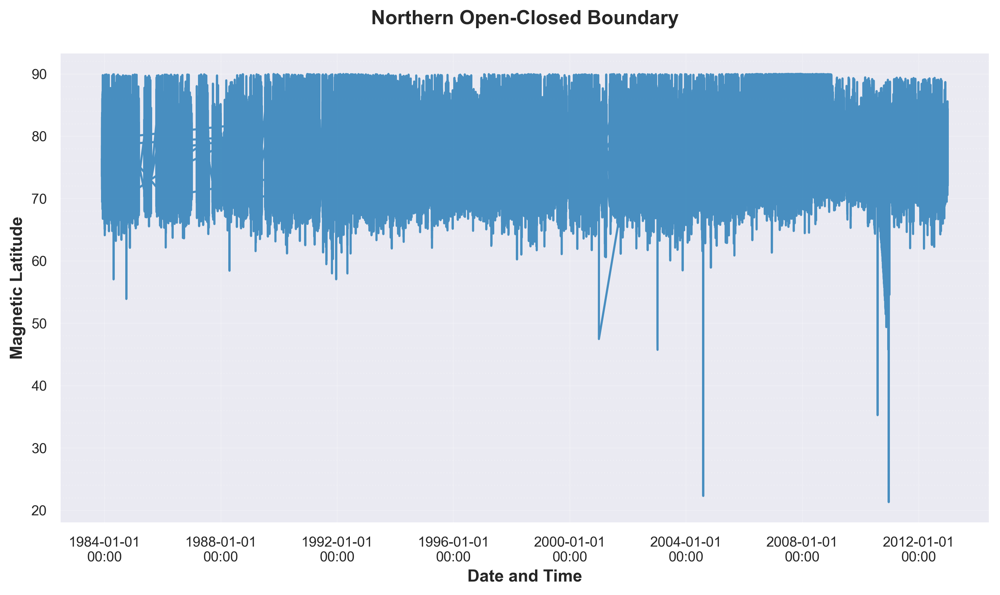

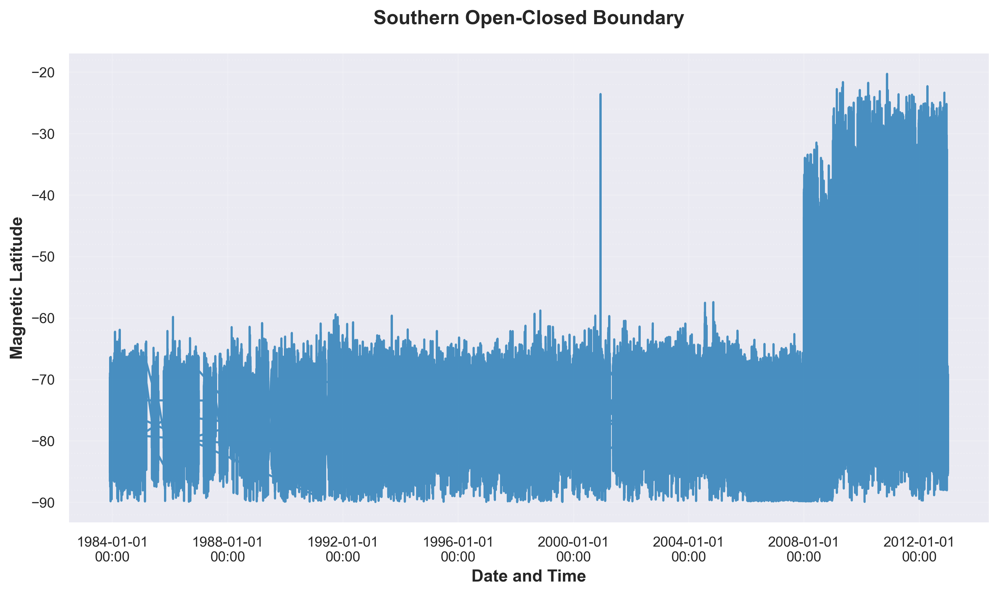

In [6]:
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import seaborn as sns
from matplotlib.ticker import AutoMinorLocator

def create_publication_plot(df, x_col='date7', y_col='mag_lat7', 
                          title='Northern Open-Closed Boundary',
                          figure_size=(10, 6), dpi=300):
    """
    Create a publication-quality time series plot.
    
    Parameters:
    -----------
    df : pandas.DataFrame
        Input dataframe containing the data
    x_col : str
        Column name for x-axis (datetime)
    y_col : str
        Column name for y-axis
    title : str
        Plot title
    figure_size : tuple
        Figure size in inches
    dpi : int
        Dots per inch for resolution
    """
    # Set the style
    plt.style.use('seaborn-v0_8-paper')
    sns.set_palette("deep")
    
    # Create figure and axis
    fig, ax = plt.subplots(figsize=figure_size, dpi=dpi)
    
    # Plot data
    ax.plot(df[x_col], df[y_col], 
            linewidth=1.5, 
            color='#1f77b4',
            alpha=0.8)
    
    # Customize grid
    ax.grid(True, which='major', linestyle='-', alpha=0.2)
    ax.grid(True, which='minor', linestyle=':', alpha=0.2)
    
    # Add minor ticks
    ax.yaxis.set_minor_locator(AutoMinorLocator())
    
    # Format date axis
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d\n%H:%M'))
    
    # Customize labels
    ax.set_xlabel('Date and Time', fontsize=12, fontweight='bold')
    ax.set_ylabel('Magnetic Latitude', fontsize=12, fontweight='bold')
    ax.set_title(title, fontsize=14, fontweight='bold', pad=20)
    
    # Customize tick labels
    ax.tick_params(axis='both', which='major', labelsize=10)
    
    # Add spines
    for spine in ax.spines.values():
        spine.set_linewidth(1.5)
    
    # Adjust layout
    plt.tight_layout()
    
    return fig, ax

# Example usage
n_ocb_nightside_df = ocb_nightside_df[ocb_nightside_df['mag_lat7'] > 0].copy()
s_ocb_nightside_df = ocb_nightside_df[ocb_nightside_df['mag_lat7'] < 0].copy()
fig, ax = create_publication_plot(n_ocb_nightside_df)
plt.savefig('plots/N_ocb_boundary.png', bbox_inches='tight', dpi=300)
fig2, ax2 = create_publication_plot(s_ocb_nightside_df, title='Southern Open-Closed Boundary')
plt.savefig('plots/S_ocb_boundary.png', bbox_inches='tight', dpi=300)
# plt.savefig('ocb_boundary.pdf', bbox_inches='tight', dpi=300)
plt.show()

In [7]:
#
# Extra
#
import plotly.graph_objs as go

lat, long = combined_nightside_df['geo_lat7'], combined_nightside_df['geo_long7']

# Create a 3D scatter plot on a globe
fig = go.Figure(data=go.Scattergeo(
    lon=long,
    lat=lat,
    mode='markers',
    marker=dict(size=10, color='red'),
))

# Update layout for a globe projection
fig.update_layout(
    title='3D Globe with Plotly',
    geo=dict(
        showland=True,
        landcolor='lightgreen',
        oceancolor='aqua',
        countrycolor='black',
        projection_type='orthographic',  # or 'natural earth', 'equirectangular', etc.
    )
)

# Show the plot
fig.show()

Notes to continue on:
1. Continue reading the 2007 Newell Paper, and draft something like it (Capturing the variance is quite astonshing)
2. Finish aggregating the nightside data into a singular .csv file. (offer to share it with Dr. Millan) (done)
3. Aggregate the dayside data as well for OCB, and run a seperate model to predict the locations. 
4. Make use of the pyplot above for boundary predictions
5. Continue drafting research paper 